In [ ]:
!git clone https://github.com/JessicaWoods03/data_analysis_work.git
!git clone https://github.com/ahmedfgad/Mask-RCNN-TF2

Cloning into 'data_analysis_work'...
remote: Enumerating objects: 638, done.
remote: Counting objects: 100% (583/583), done.
remote: Compressing objects: 100% (509/509), done.
remote: Total 638 (delta 208), reused 109 (delta 72), pack-reused 55
Receiving objects: 100% (638/638), 239.16 MiB | 25.79 MiB/s, done.
Resolving deltas: 100% (212/212), done.
Updating files: 100% (437/437), done.
Error downloading object: FLAT_RCL.txt (04160d8): Smudge error: Error downloading FLAT_RCL.txt (04160d8479f080521d1f167bdb0bd0b4c721b8b859b5c59833045d970bff30a6): batch response: This repository is over its data quota. Account responsible for LFS bandwidth should purchase more data packs to restore access.

Errors logged to /content/data_analysis_work/.git/lfs/logs/20240606T151520.034870103.log
Use `git lfs logs last` to view the log.
error: external filter 'git-lfs filter-process' failed
fatal: FLAT_RCL.txt: smudge filter lfs failed
You can inspect what was checked out with 'git status'
and retry with 

In [ ]:
#importing packages
import tensorflow as tf
import cv2
import os
import matplotlib.pyplot as plt
import pandas as pd
import json

In [ ]:
!pwd

/content/data_analysis_work


In [ ]:
%cd data_analysis_work/
!ls

directories = ['first_50', 'second_50', 'third_50', 'fourth_50', 'fifth_50', 'sixth_50']
directoryCSV = ['annotations_1']

all_photos = []

def load_photos_from_directory(directory):
    photos = []
    for filename in os.listdir(directory):
        if filename.endswith(".jpg"):
            photo_path = os.path.join(directory, filename)
            photo = cv2.imread(photo_path)
            if photo is not None:
                photos.append(photo)
    return photos

for directory in directories:
    try:
        %cd "{directory}"
        !ls
        photos = load_photos_from_directory('.')
        all_photos.extend(photos)
        %cd ..
    except FileNotFoundError:
        print(f"Directory '{directory}' not found.")

[Errno 2] No such file or directory: 'data_analysis_work/'
/content/data_analysis_work
 24-testcar-2024-01-29.csv   fifth_50	'Inflation and Violence'   LICENSE     third_50
 annotations_1.csv	     first_100	 Iris_Solution		   README.md
 China_India_analysis	     first_50	 labeled_images		   second_50
 data			     fourth_50	 labeled_images_2	   sixth_50
/content/data_analysis_work/first_50
0.jpg	14.jpg	19.jpg	23.jpg	28.jpg	32.jpg	37.jpg	41.jpg	46.jpg	50.jpg	9.jpg
10.jpg	15.jpg	1.jpg	24.jpg	29.jpg	33.jpg	38.jpg	42.jpg	47.jpg	5.jpg
11.jpg	16.jpg	20.jpg	25.jpg	2.jpg	34.jpg	39.jpg	43.jpg	48.jpg	6.jpg
12.jpg	17.jpg	21.jpg	26.jpg	30.jpg	35.jpg	3.jpg	44.jpg	49.jpg	7.jpg
13.jpg	18.jpg	22.jpg	27.jpg	31.jpg	36.jpg	40.jpg	45.jpg	4.jpg	8.jpg
/content/data_analysis_work
/content/data_analysis_work/second_50
100.jpg  55.jpg  60.jpg  65.jpg  70.jpg  75.jpg  80.jpg  85.jpg  90.jpg  95.jpg
51.jpg	 56.jpg  61.jpg  66.jpg  71.jpg  76.jpg  81.jpg  86.jpg  91.jpg  96.jpg
52.jpg	 57.jpg  62.jpg  67.jpg  72.j

Github has a limit of like 51 images per load before the file is too big..
I need to ensure that we have a static link to the file so we both can work on this together in colabs-

In [ ]:
import os
import json

directory = 'labeled_images'

all_json_data = []

def load_json_from_directory(directory):
    json_data = []
    for filename in os.listdir(directory):
        if filename.endswith(".json"):
            with open(os.path.join(directory, filename), 'r') as json_file:
                data = json.load(json_file)
                json_data.append(data)
    return json_data

try:
    %cd "{directory}"
    !ls
    json_data = load_json_from_directory('.')
    all_json_data.extend(json_data)
    %cd ..

except FileNotFoundError:
    print(f"Directory '{directory}' not found.")

df_csv = ''
try:
    %cd "{directoryCSV}"
    df_csv = pd.read_csv('annotations_1.csv')
    print(df_csv)
    %cd ..
except FileNotFoundError:
    print(f"Directory '{directoryCSV}' not found.")

/content/data_analysis_work/labeled_images
 image_10.json	 image_19.json	 image_27.json	 image_35.json	 image_43.json	 image_51.json
 image_11.json	 image_1.json	 image_28.json	 image_36.json	 image_44.json	 image_52.json
 image_12.json	 image_20.json	 image_29.json	 image_37.json	 image_45.json	 image_5.json
 image_13.json	 image_21.json	 image_2.json	 image_38.json	 image_46.json	 image_6.json
 image_14.json	 image_22.json	 image_30.json	 image_39.json	 image_47.json	 image_7.json
 image_15.json	 image_23.json	 image_31.json	 image_3.json	 image_48.json	'image_8 (1).json'
 image_16.json	 image_24.json	 image_32.json	 image_40.json	 image_49.json	 image_9.json
 image_17.json	 image_25.json	 image_33.json	 image_41.json	 image_4.json
 image_18.json	 image_26.json	 image_34.json	 image_42.json	 image_50.json
/content/data_analysis_work
[Errno 2] No such file or directory: "['annotations_1']"
/content/data_analysis_work
      filename   width  height      species  xmin  ymin  xmax  ymax


xmin: The x-coordinate of the top-left corner of the bounding box.<br>
ymin: The y-coordinate of the top-left corner of the bounding box.<br>
xmax: The x-coordinate of the bottom-right corner of the bounding box.<br>
ymax: The y-coordinate of the bottom-right corner of the bounding box.<br>


In [ ]:
df_csv.head()

,filename,width,height,species,xmin,ymin,xmax,ymax
0,62.jpg,736013,736013,COT,529,512,672,617
1,62.jpg,736013,736013,surgeonfish,298,572,354,603
2,62.jpg,736013,736013,F_coral,231,57,341,119
3,62.jpg,736013,736013,F_coral,748,210,989,331
4,62.jpg,736013,736013,S_coral,829,215,931,293


In [ ]:
df_csv.shape

(7932, 8)

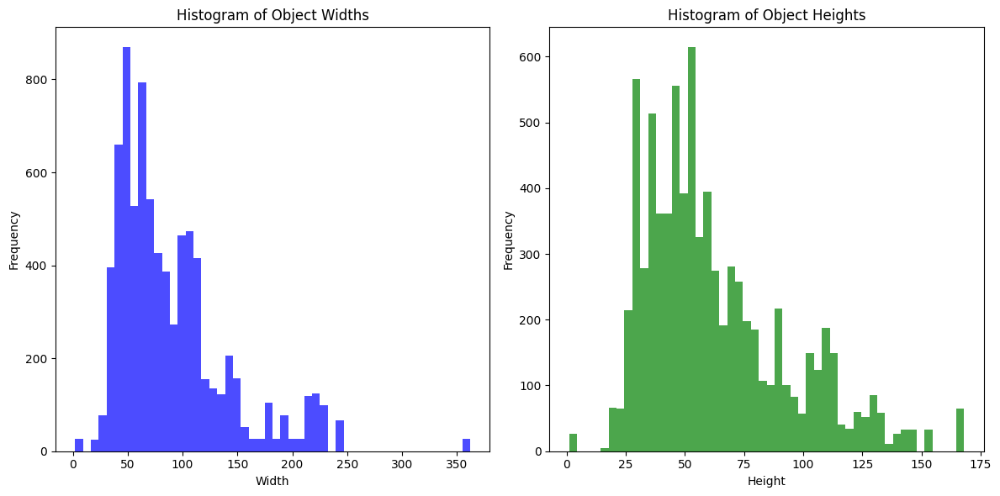

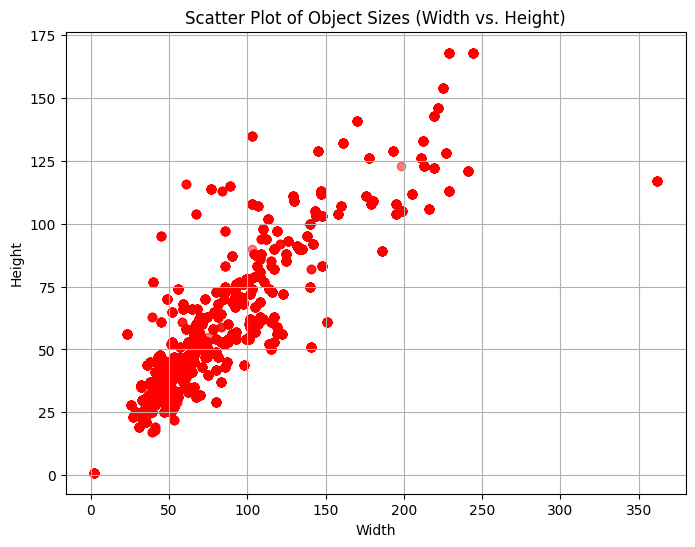

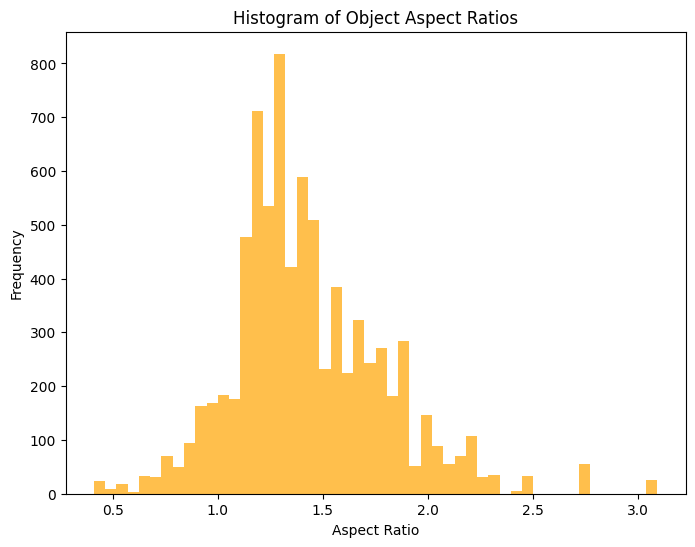

In [ ]:
# bounding box statistics
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df_csv['width'] = df_csv['xmax'] - df_csv['xmin']
df_csv['height'] = df_csv['ymax'] - df_csv['ymin']
df_csv['aspect_ratio'] = df_csv['width'] / df_csv['height']

# histograms of width and height
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.hist(df_csv['width'], bins=50, color='blue', alpha=0.7)
plt.xlabel('Width')
plt.ylabel('Frequency')
plt.title('Histogram of Object Widths')

plt.subplot(1, 2, 2)
plt.hist(df_csv['height'], bins=50, color='green', alpha=0.7)
plt.xlabel('Height')
plt.ylabel('Frequency')
plt.title('Histogram of Object Heights')

plt.tight_layout()
plt.show()

# Scatter plot of object aspect ratios
plt.figure(figsize=(8, 6))
plt.scatter(df_csv['width'], df_csv['height'], color='red', alpha=0.5)
plt.xlabel('Width')
plt.ylabel('Height')
plt.title('Scatter Plot of Object Sizes (Width vs. Height)')
plt.grid(True)
plt.show()

# histogram of object aspect ratios
plt.figure(figsize=(8, 6))
plt.hist(df_csv['aspect_ratio'], bins=50, color='orange', alpha=0.7)
plt.xlabel('Aspect Ratio')
plt.ylabel('Frequency')
plt.title('Histogram of Object Aspect Ratios')
plt.show()

In [ ]:
%cd /content/data_analysis_work/

/content/data_analysis_work


In [ ]:
!ls

 24-testcar-2024-01-29.csv   fifth_50	'Inflation and Violence'   LICENSE     third_50
 annotations_1.csv	     first_100	 Iris_Solution		   README.md
 China_India_analysis	     first_50	 labeled_images		   second_50
 data			     fourth_50	 labeled_images_2	   sixth_50


In [ ]:
# Loading JSON files from labeled images 1 and 2
json_100_data = []

try:

    %cd "labeled_images"
    !ls

    json_data = load_json_from_directory('.')
    json_100_data.extend(json_data)

    %cd ..

except FileNotFoundError:
    print(f"Directory '{directory}' not found.")

directory2 = 'labeled_images_2'
try:
    %cd "{directory2}"
    !ls
    json_data = load_json_from_directory('.')

    json_100_data.extend(json_data)

    %cd ..

except FileNotFoundError:
    print(f"Directory '{directory}' not found.")
print(f"Number of json loaded: {len(json_100_data)}")

/content/data_analysis_work/labeled_images
 image_10.json	 image_19.json	 image_27.json	 image_35.json	 image_43.json	 image_51.json
 image_11.json	 image_1.json	 image_28.json	 image_36.json	 image_44.json	 image_52.json
 image_12.json	 image_20.json	 image_29.json	 image_37.json	 image_45.json	 image_5.json
 image_13.json	 image_21.json	 image_2.json	 image_38.json	 image_46.json	 image_6.json
 image_14.json	 image_22.json	 image_30.json	 image_39.json	 image_47.json	 image_7.json
 image_15.json	 image_23.json	 image_31.json	 image_3.json	 image_48.json	'image_8 (1).json'
 image_16.json	 image_24.json	 image_32.json	 image_40.json	 image_49.json	 image_9.json
 image_17.json	 image_25.json	 image_33.json	 image_41.json	 image_4.json
 image_18.json	 image_26.json	 image_34.json	 image_42.json	 image_50.json
/content/data_analysis_work
/content/data_analysis_work/labeled_images_2
image_100.json	image_60.json  image_68.json  image_76.json  image_84.json  image_92.json
image_53.json	image

**Data Exploration**

Number of photos loaded: 301


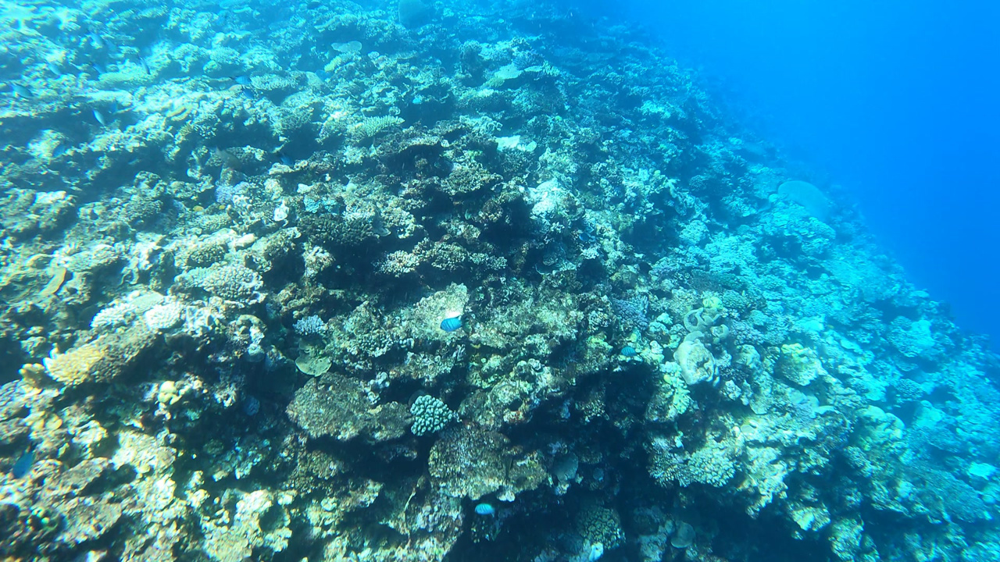

In [ ]:
# Loading all photos using OpenCV
import cv2
import os
from google.colab.patches import cv2_imshow

print(f"Number of photos loaded: {len(all_photos)}")

if len(all_photos) > 0:
    cv2_imshow(all_photos[0])
else:
    print("No photos found in the directory.")


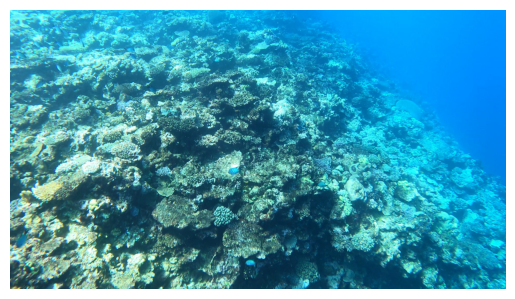

In [ ]:
# Check if any photos are loaded
if len(all_photos) > 0:
    image = all_photos[0]
    if len(image.shape) == 2 or image.shape[2] == 1:
        image = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)
    elif image.shape[2] == 4:
        image = cv2.cvtColor(image, cv2.COLOR_RGBA2RGB)
    elif image.shape[2] == 3:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    plt.imshow(image)
    plt.axis('off')
    plt.show()

In [ ]:
for idx, image in enumerate(all_photos):
    print(f"Image {idx}: shape = {image.shape}, dtype = {image.dtype}")

print(all_photos, "Sample Image Grid")

Streaming output truncated to the last 5000 lines.

       [[ 62,  58,   5],
        [ 59,  60,  10],
        [ 69,  60,  17],
        ...,
        [124,  89,   0],
        [128,  88,   0],
        [132,  89,   2]]], dtype=uint8), array([[[152, 112,   6],
        [152, 111,   8],
        [154, 111,   8],
        ...,
        [255, 146,   0],
        [255, 146,   0],
        [255, 146,   0]],

       [[159, 122,   8],
        [157, 120,   6],
        [155, 114,   5],
        ...,
        [255, 146,   0],
        [255, 146,   0],
        [255, 146,   0]],

       [[163, 129,   6],
        [163, 128,   8],
        [161, 123,   5],
        ...,
        [255, 146,   0],
        [255, 146,   0],
        [255, 146,   0]],

       ...,

       [[100,  65,  31],
        [104,  61,  22],
        [131,  68,  18],
        ...,
        [184, 171,   9],
        [187, 162,  12],
        [184, 148,  10]],

       [[101,  72,  35],
        [106,  69,  25],
        [129,  69,  23],
        ...,
        

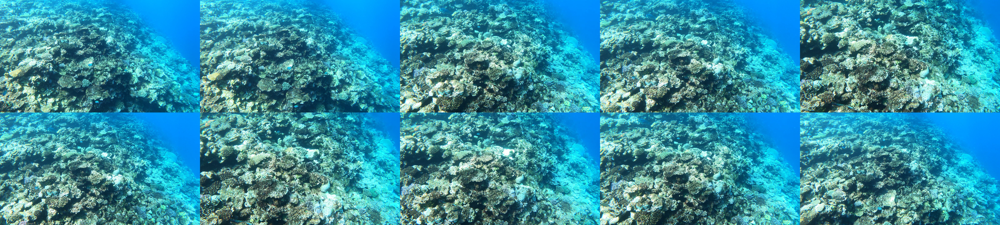

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

def photo_grid(images, grid_size=(2, 5), image_size=(1280, 720)):

    rows, cols = grid_size
    width, height = image_size

    grid_image = np.zeros((height * rows, width * cols, 3), dtype=np.uint8)

    for idx, image in enumerate(images):
        if idx >= rows * cols:
            break
        resized_image = cv2.resize(image, (width, height))
        row = idx // cols
        col = idx % cols

        grid_image[row * height:(row + 1) * height, col * width:(col + 1) * width, :] = resized_image

    return grid_image

combined_image = photo_grid(all_photos, grid_size=(2, 5), image_size=(1280, 720))

cv2_imshow(combined_image)

In [ ]:
import cv2
import matplotlib.pyplot as plt

# Function to calculate dimensions and aspect ratios
def calculate_image_stats(images):
    dimensions = []
    aspect_ratios = []

    for idx, image in enumerate(images):
        height, width = image.shape[:2]
        dimensions.append((width, height))
        aspect_ratio = width / height
        aspect_ratios.append(aspect_ratio)
        print(f"Image {idx}: Width = {width}, Height = {height}, Aspect Ratio = {aspect_ratio:.2f}")

    return dimensions, aspect_ratios
dimensions, aspect_ratios = calculate_image_stats(all_photos)

Image 0: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 1: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 2: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 3: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 4: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 5: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 6: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 7: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 8: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 9: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 10: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 11: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 12: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 13: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 14: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 15: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 16: Width = 1280, Height = 720, Aspect Ratio = 1.78
Image 17: Width = 1280, 

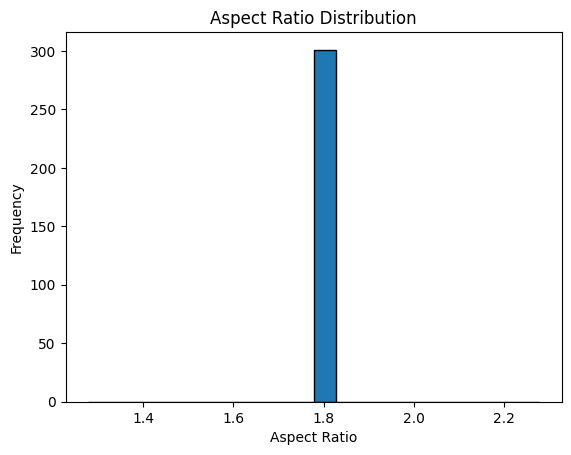

In [ ]:
# Aspect ratios
plt.hist(aspect_ratios, bins=20, edgecolor='black')
plt.title('Aspect Ratio Distribution')
plt.xlabel('Aspect Ratio')
plt.ylabel('Frequency')
plt.show()

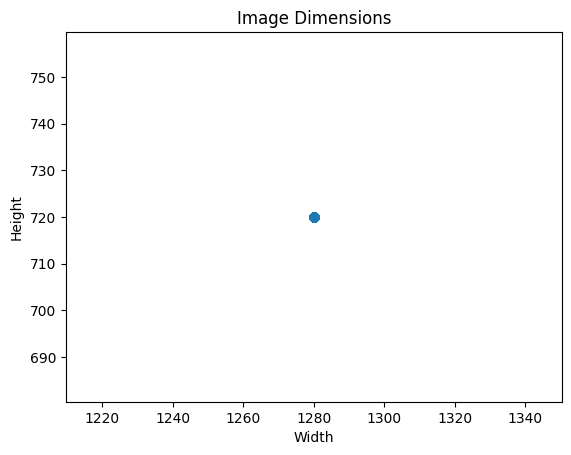

In [ ]:
# dimensions
widths, heights = zip(*dimensions)
plt.scatter(widths, heights, alpha=0.5)
plt.title('Image Dimensions')
plt.xlabel('Width')
plt.ylabel('Height')
plt.show()

In [ ]:
import json
import matplotlib.pyplot as plt
from collections import Counter

bounding_box_sizes = []
aspect_ratios = []
labels = []

for annotation in json_100_data:
    if '_via_img_metadata' in annotation:
        img_metadata = annotation['_via_img_metadata']
        for image_id, image_data in img_metadata.items():
            if 'regions' in image_data:
                for region in image_data['regions']:
                    if 'shape_attributes' in region:
                        shape_attributes = region['shape_attributes']
                        width = shape_attributes.get('width')
                        height = shape_attributes.get('height')
                        if width is not None and height is not None:
                            bounding_box_size = width * height
                            aspect_ratio = width / height
                            bounding_box_sizes.append((width, height))
                            aspect_ratios.append(aspect_ratio)
                            print(f"Processed bounding box: Width = {width}, Height = {height}, Size = {bounding_box_size}, Aspect Ratio = {aspect_ratio:.2f}")

                            if 'region_attributes' in region:
                                region_attributes = region['region_attributes']
                                label = region_attributes.get('species', 'Unknown')
                                labels.append(label)

# Analyzing label distribution
label_counts = Counter(labels)
print("Label distribution:", label_counts)

Streaming output truncated to the last 5000 lines.
Processed bounding box: Width = 41, Height = 28, Size = 1148, Aspect Ratio = 1.46
Processed bounding box: Width = 46, Height = 31, Size = 1426, Aspect Ratio = 1.48
Processed bounding box: Width = 71, Height = 60, Size = 4260, Aspect Ratio = 1.18
Processed bounding box: Width = 51, Height = 43, Size = 2193, Aspect Ratio = 1.19
Processed bounding box: Width = 43, Height = 47, Size = 2021, Aspect Ratio = 0.91
Processed bounding box: Width = 36, Height = 31, Size = 1116, Aspect Ratio = 1.16
Processed bounding box: Width = 69, Height = 62, Size = 4278, Aspect Ratio = 1.11
Processed bounding box: Width = 49, Height = 43, Size = 2107, Aspect Ratio = 1.14
Processed bounding box: Width = 53, Height = 47, Size = 2491, Aspect Ratio = 1.13
Processed bounding box: Width = 48, Height = 29, Size = 1392, Aspect Ratio = 1.66
Processed bounding box: Width = 36, Height = 31, Size = 1116, Aspect Ratio = 1.16
Processed bounding box: Width = 79, Height = 65

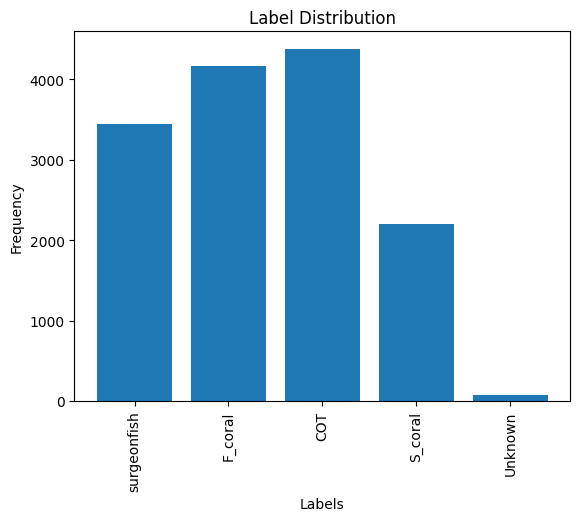

In [ ]:
# Plot label distribution
plt.bar(label_counts.keys(), label_counts.values())
plt.title("Label Distribution")
plt.xlabel("Labels")
plt.ylabel("Frequency")
plt.xticks(rotation=90)
plt.show()

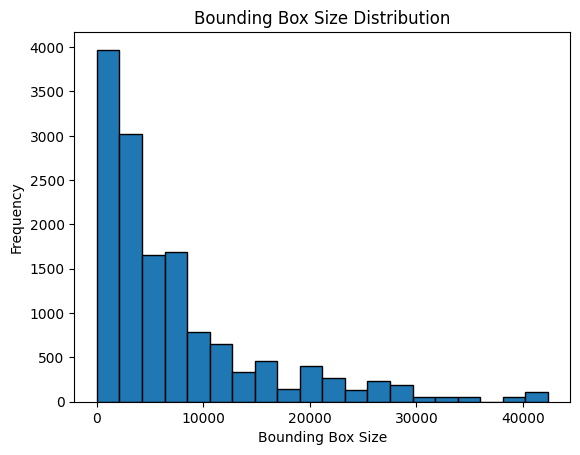

In [ ]:
# Plot bounding box sizes
widths, heights = zip(*bounding_box_sizes)
plt.hist([w * h for w, h in bounding_box_sizes], bins=20, edgecolor='black')
plt.title('Bounding Box Size Distribution')
plt.xlabel('Bounding Box Size')
plt.ylabel('Frequency')
plt.show()

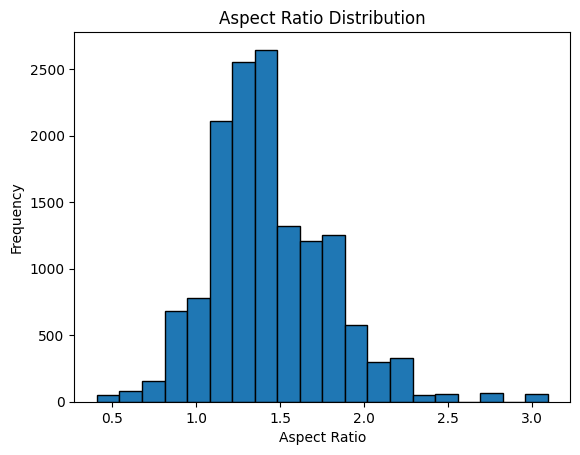

In [ ]:
# Plot aspect ratios
plt.hist(aspect_ratios, bins=20, edgecolor='black')
plt.title('Aspect Ratio Distribution')
plt.xlabel('Aspect Ratio')
plt.ylabel('Frequency')
plt.show()

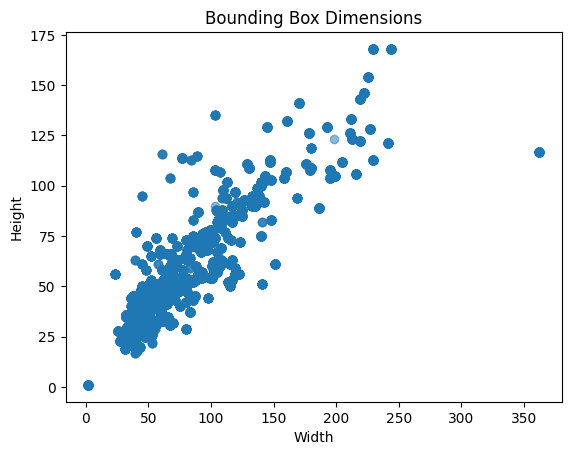

In [ ]:
# Scatter plot of bounding box sizes
plt.scatter(widths, heights, alpha=0.5)
plt.title('Bounding Box Dimensions')
plt.xlabel('Width')
plt.ylabel('Height')
plt.show()

**Evaluate using Machine learning Model: Random Forest**

In [ ]:
nan_values = df_csv.isna().sum()
print("NaN values per column:")
print(nan_values)

nan_values_in_species_column = df_csv['species'].isna().sum()
print("\nNaN values in 'species' column:", nan_values_in_species_column)

df_clean = df_csv.dropna()

NaN values per column:
filename         0
width            0
height           0
species         26
xmin             0
ymin             0
xmax             0
ymax             0
aspect_ratio     0
dtype: int64

NaN values in 'species' column: 26


In [ ]:
nan_values = df_clean.isna().sum()
print("NaN values per column:")
print(nan_values)

NaN values per column:
filename        0
width           0
height          0
species         0
xmin            0
ymin            0
xmax            0
ymax            0
aspect_ratio    0
dtype: int64


In [ ]:
df_clean.shape

(7906, 9)

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

bounding_box_count = df_clean.groupby('filename').size().reset_index(name='bounding_box_count')

df_merged = pd.merge(df_clean, bounding_box_count, on='filename')

X = df_merged[['bounding_box_count']]
y = df_merged['species']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = LogisticRegression()

model.fit(X_train, y_train)

y_pred = model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.3609355246523388


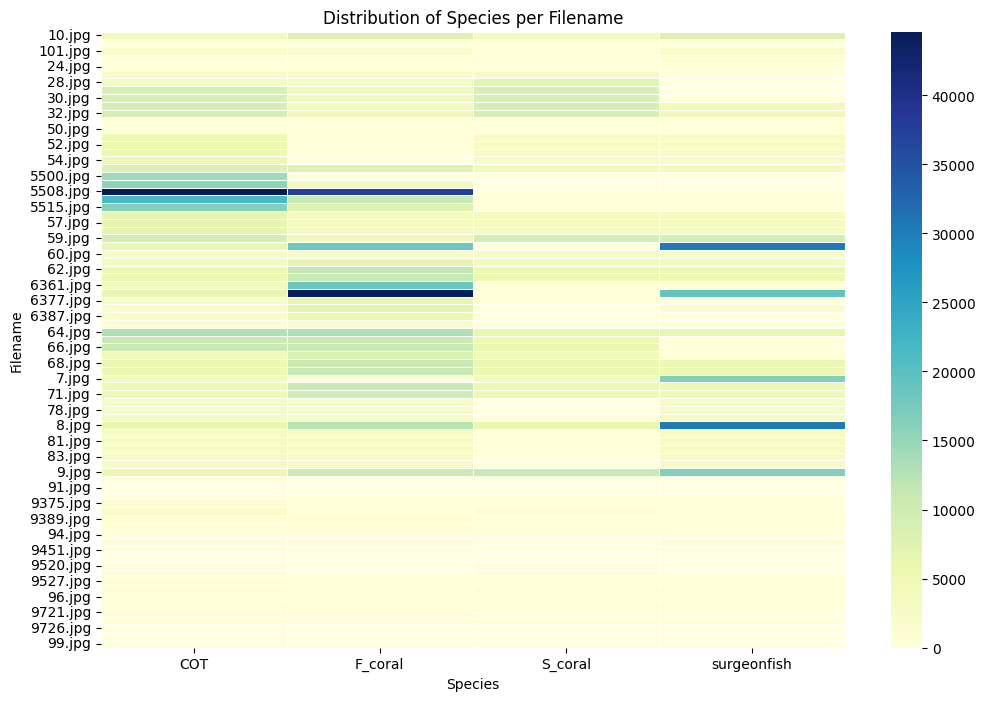

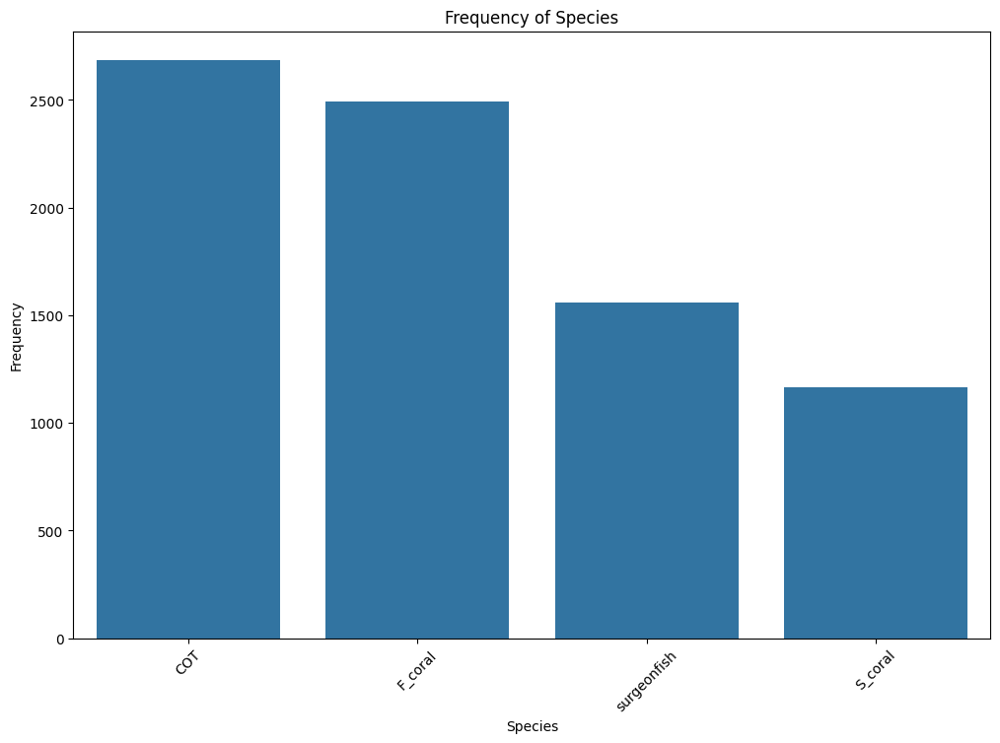

In [ ]:
# count of bounding boxes per file
df_merged = pd.merge(df_clean, bounding_box_count, on='filename')
species_per_filename_pivot = df_merged.pivot_table(index='filename', columns='species', values='bounding_box_count', aggfunc='sum').fillna(0)

# heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(species_per_filename_pivot, cmap='YlGnBu', linewidths=0.5)
plt.title('Distribution of Species per Filename')
plt.xlabel('Species')
plt.ylabel('Filename')
plt.show()

# species frequency
plt.figure(figsize=(12, 8))
sns.countplot(data=df_csv, x='species', order=df_csv['species'].value_counts().index)
plt.title('Frequency of Species')
plt.xlabel('Species')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
# Random Forest model
model_rf = RandomForestClassifier(n_estimators=100, random_state=42)

model_rf.fit(X_train, y_train)

y_pred_rf = model_rf.predict(X_test)

accuracy_rf = accuracy_score(y_test, y_pred_rf)
print("Random Forest Accuracy:", accuracy_rf)

Random Forest Accuracy: 0.42920353982300885


In [ ]:
from sklearn.utils.class_weight import compute_class_weight
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

X = df_merged[['bounding_box_count']]
y = df_merged['species']

class_labels = df_merged['species'].unique()
class_weights = compute_class_weight(class_weight='balanced', classes=class_labels, y=y)

class_weight_dict = dict(zip(class_labels, class_weights))

model_rf_weighted = RandomForestClassifier(n_estimators=100, random_state=42, class_weight=class_weight_dict)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model_rf_weighted.fit(X_train, y_train)

y_pred_rf_weighted = model_rf_weighted.predict(X_test)

accuracy_rf_weighted = accuracy_score(y_test, y_pred_rf_weighted)
print("Random Forest Accuracy with Class Weights:", accuracy_rf_weighted)

Random Forest Accuracy with Class Weights: 0.3780025284450063


In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("Confusion Matrix:")
print(conf_matrix)
print("Classification Report:")
print(class_report)

Accuracy: 0.3609355246523388
Confusion Matrix:
[[332 204   0   0]
 [256 239   0   0]
 [144 108   0   0]
 [157 142   0   0]]
Classification Report:
              precision    recall  f1-score   support

         COT       0.37      0.62      0.47       536
     F_coral       0.34      0.48      0.40       495
     S_coral       0.00      0.00      0.00       252
 surgeonfish       0.00      0.00      0.00       299

    accuracy                           0.36      1582
   macro avg       0.18      0.28      0.22      1582
weighted avg       0.23      0.36      0.28      1582



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


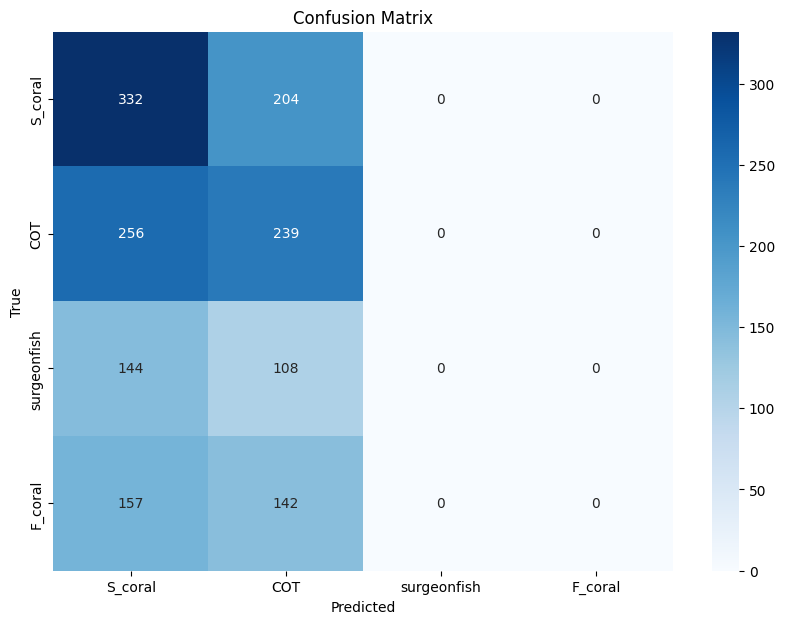

In [ ]:
# confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=set(y), yticklabels=set(y))
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


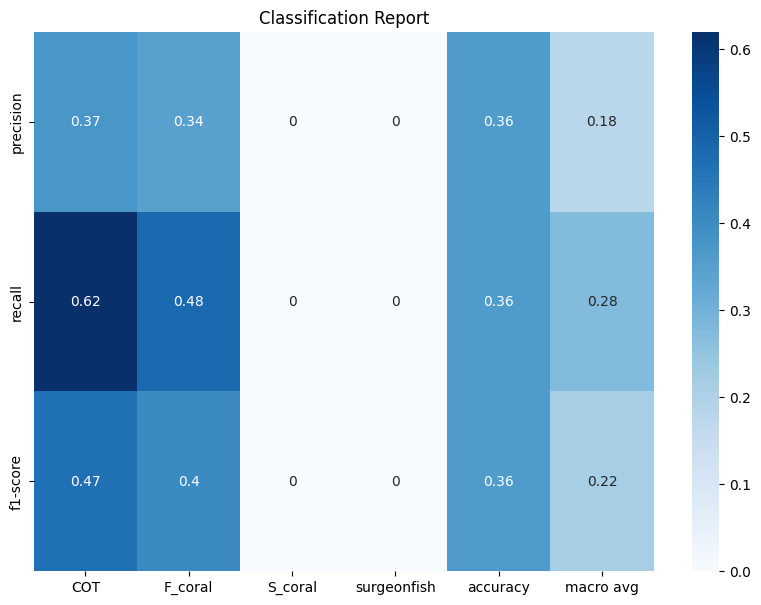

In [ ]:
# classification report
report = classification_report(y_test, y_pred, output_dict=True)
report_df = pd.DataFrame(report).transpose()

plt.figure(figsize=(10, 7))
sns.heatmap(report_df.iloc[:-1, :-1].T, annot=True, cmap='Blues')
plt.title('Classification Report')
plt.show()

In [ ]:
#Running MASK RCNN model

In [ ]:
!ls Mask_RCNN-TF2

ls: cannot access 'Mask_RCNN-TF2': No such file or directory


In [ ]:
%cd ..

/content


In [ ]:
%cd Mask-RCNN-TF2

/content/Mask-RCNN-TF2


In [ ]:
# Importing Mask R-CNN repository
#!git clone https://github.com/matterport/Mask_RCNN.git
%cd Mask_RCNN-TF2
!python setup.py install
!pip install -r requirements.txt

[Errno 2] No such file or directory: 'Mask_RCNN-TF2'
/content/Mask-RCNN-TF2
/usr/local/lib/python3.10/dist-packages/setuptools/dist.py:755: SetuptoolsDeprecationWarning: Invalid dash-separated options
!!

        ********************************************************************************
        Usage of dash-separated 'description-file' will not be supported in future
        versions. Please use the underscore name 'description_file' instead.

        This deprecation is overdue, please update your project and remove deprecated
        calls to avoid build errors in the future.

        See https://setuptools.pypa.io/en/latest/userguide/declarative_config.html for details.
        ********************************************************************************

!!
  opt = self.warn_dash_deprecation(opt, section)
/usr/local/lib/python3.10/dist-packages/setuptools/dist.py:755: SetuptoolsDeprecationWarning: Invalid dash-separated options
!!

        ********************************

In [ ]:
import datetime
def via_to_coco(via_json_data):
    coco_data = {
        "info": {
            "description": "Dataset converted from VIA annotations",
            "url": "",
            "version": "1.0",
            "year": datetime.datetime.now().year,
            "contributor": "",
            "date_created": datetime.datetime.now().isoformat()
        },
        "licenses": [],
        "images": [],
        "annotations": [],
        "categories": []
    }

    category_mapping = {
        "F_coral": 1,
        "S_coral": 2,
        "COT": 3,
        "surgeonfish": 4
    }

    for name, id in category_mapping.items():
        coco_data["categories"].append({
            "id": id,
            "name": name,
            "supercategory": "none"
        })
    annotation_id = 1
    for data_dict in via_json_data:
      if '_via_img_metadata' in data_dict:
        for file_data in data_dict['_via_img_metadata'].values():
            print(file_data)
            file_name = file_data['filename']
            file_regions = file_data['regions']
            image_id = int(os.path.splitext(file_name)[0])

            coco_data["images"].append({
                "id": image_id,
                "width": file_data.get('width', 1280),
                "height": file_data.get('height', 720),
                "file_name": file_name,
                "license": 0,
                "flickr_url": "",
                "coco_url": "",
                "date_captured": datetime.datetime.now().isoformat()
            })

            for region in file_regions:
                shape_attributes = region['shape_attributes']
                region_attributes = region['region_attributes']
                category_name = region_attributes.get('name')
                category_id = category_mapping.get('species')
                bbox = [shape_attributes['x'], shape_attributes['y'],
                        shape_attributes['width'], shape_attributes['height']]
                segmentation = [[
                    shape_attributes['x'], shape_attributes['y'],
                    shape_attributes['x'] + shape_attributes['width'], shape_attributes['y'],
                    shape_attributes['x'] + shape_attributes['width'], shape_attributes['y'] + shape_attributes['height'],
                    shape_attributes['x'], shape_attributes['y'] + shape_attributes['height']
                ]]

                coco_data["annotations"].append({
                    "id": annotation_id,
                    "image_id": image_id,
                    "category_id": category_id,
                    "bbox": bbox,
                    "segmentation": segmentation,
                    "area": shape_attributes['width'] * shape_attributes['height'],
                    "iscrowd": 0
                })
                annotation_id += 1

    return coco_data

coco_data = via_to_coco(json_100_data)

with open('../data_analysis_work/annotations.json', 'w') as outfile:
    json.dump(coco_data, outfile)


{'filename': '1.jpg', 'size': 635290, 'regions': [{'shape_attributes': {'name': 'rect', 'x': 570, 'y': 360, 'width': 41, 'height': 30}, 'region_attributes': {'species': 'surgeonfish'}}, {'shape_attributes': {'name': 'rect', 'x': 53, 'y': 503, 'width': 41, 'height': 43}, 'region_attributes': {'species': 'surgeonfish'}}, {'shape_attributes': {'name': 'rect', 'x': 368, 'y': 444, 'width': 110, 'height': 84}, 'region_attributes': {'species': 'F_coral'}}, {'shape_attributes': {'name': 'rect', 'x': 542, 'y': 520, 'width': 105, 'height': 82}, 'region_attributes': {'species': 'F_coral'}}, {'shape_attributes': {'name': 'rect', 'x': 698, 'y': 307, 'width': 38, 'height': 40}, 'region_attributes': {'species': 'COT'}}, {'shape_attributes': {'name': 'rect', 'x': 350, 'y': 156, 'width': 35, 'height': 35}, 'region_attributes': {'species': 'surgeonfish'}}], 'file_attributes': {'caption': '', 'public_domain': 'no', 'image_url': ''}}
{'filename': '2.jpg', 'size': 633583, 'regions': [{'shape_attributes': {

In [ ]:
from mrcnn.config import Config
from mrcnn import utils

class CustomConfig(Config):
    NAME = "coral"
    IMAGES_PER_GPU = 2
    NUM_CLASSES = 1 + 4
    STEPS_PER_EPOCH = 100
    DETECTION_MIN_CONFIDENCE = 0.9

class CustomDataset(utils.Dataset):
    def load_custom(self, annotation_json, images_dir):

        # annotations loaded
        with open(annotation_json) as f:
            annotations = json.load(f)

        for category in annotations['categories']:
            self.add_class("coral", category['id'], category['name'])

        # images added
        for image in annotations['images']:
            image_path = os.path.join(images_dir, image['file_name'])
            self.add_image(
                "coral",
                image_id=image['id'],
                path=image_path,
                width=image['width'],
                height=image['height'],
                annotations=[a for a in annotations['annotations'] if a['image_id'] == image['id']]
            )

    def load_mask(self, image_id):
        info = self.image_info[image_id]
        annotations = info['annotations']
        masks = np.zeros([info['height'], info['width'], len(annotations)], dtype=np.uint8)
        class_ids = np.zeros(len(annotations), dtype=np.int32)

        for i, annotation in enumerate(annotations):
            bbox = annotation['bbox']
            mask = np.zeros([info['height'], info['width']], dtype=np.uint8)
            mask[bbox[1]:bbox[1]+bbox[3], bbox[0]:bbox[0]+bbox[2]] = 1
            masks[:, :, i] = mask
            class_ids[i] = annotation['category_id']

        return masks, class_ids.astype(np.int32)


In [ ]:
# Mask R-CNN imports
from mrcnn.model import MaskRCNN
from mrcnn.config import Config
from mrcnn import model as modellib, utils
from mrcnn.visualize import display_instances
from mrcnn.model import log

# Training dataset
dataset_train = CustomDataset()
print(type(dataset_train))
dataset_train.load_custom('../data_analysis_work/annotations.json', '/content/data_analysis_work/labeled_images')
dataset_train.prepare()

# Validation dataset
dataset_val = CustomDataset()
dataset_val.load_custom('../data_analysis_work/annotations.json', '/content/data_analysis_work/labeled_images_2')
dataset_val.prepare()

# Creating MASK-R-CNN model
config = CustomConfig()
model = modellib.MaskRCNN(mode="training", config=config, model_dir='/content/logs')

#utilizing pre-trained model
COCO_MODEL_PATH = 'mask_rcnn_coco.h5'
model.load_weights(COCO_MODEL_PATH, by_name=True, exclude=[
    "mrcnn_class_logits", "mrcnn_bbox_fc", "mrcnn_bbox", "mrcnn_mask"])

# Model training
model.train(dataset_train, dataset_val,
            learning_rate=config.LEARNING_RATE,
            epochs=30,
            layers='heads')


/content/Mask-RCNN-TF2/mrcnn/model.py:2369: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if os.name is 'nt':


<class '__main__.CustomDataset'>


TypeError: Could not build a TypeSpec for KerasTensor(type_spec=TensorSpec(shape=(None, None, 4), dtype=tf.float32, name=None), name='tf.math.truediv/truediv:0', description="created by layer 'tf.math.truediv'") of unsupported type <class 'keras.src.engine.keras_tensor.KerasTensor'>.

Model doesnt work on google collab or jupyter notebook
- Debugging:
MRCNN model requires older versions of Python and TensorFlow to run, specifically Python 3.6.0 and TensorFlow 2.0.0. Also, Google Colab's environment only supports Python 3.8.0 and above and TensorFlow 2.15.0 and above.

Thus, this model was not able to run due to the outdated python/TF packages that is incompatable with google collab/jupyter notebook/kaggle notebook IDE environment, which was tested on.